<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"></ul></div>

In [1]:
import numpy as np
import os
%matplotlib inline
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D  # noqa: F401 unused import
import matplotlib.cm as cm
from scipy.integrate import odeint
from scipy.integrate import solve_ivp
from scipy.optimize import fsolve
import warnings
warnings.filterwarnings("error")
import logging
import sys
sys.path.insert(0,'../fortran-package') # carico la directory con i pacchetti
from maps import lorentz
from matplotlib import animation
from IPython.display import HTML
import plotly.graph_objects as go
import plotly.io as pio

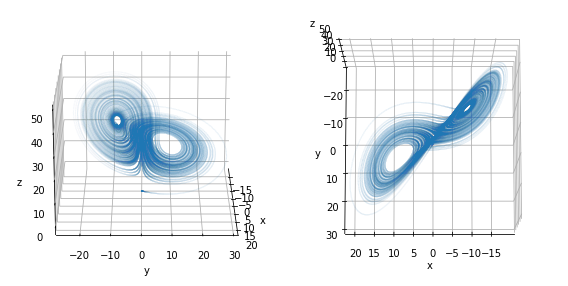

In [46]:
def main():
    fig = plt.figure(figsize=(8,6))
    ax1 = fig.add_subplot(121, projection='3d')
    ax2 = fig.add_subplot(122, projection='3d')

    n = 100000
    s, r, b = 10, 28, 8/3
    h = 0.001
    v0 = np.ones(n)
    x0, y0, z0 = 0.1,0,0
    
    x, y, z = v0*x0, v0*y0, v0*z0
    lorentz(x, y, z, h, s, r, b)
    ax1.scatter(x, y, z, s = 0.001) 
    ax2.scatter(x, y, z, s = 0.001)  

    ax1.set_xlabel('x')
    ax2.set_xlabel('x')

    ax1.set_ylabel('y')
    ax2.set_ylabel('y')

    ax1.set_zlabel('z')
    ax2.set_zlabel('z')

    ax1.xaxis.pane.fill = False
    ax1.yaxis.pane.fill = False
    ax1.zaxis.pane.fill = False

    # Now set color to white (or whatever is "invisible")
    ax1.xaxis.pane.set_edgecolor('w')
    ax1.yaxis.pane.set_edgecolor('w')
    ax1.zaxis.pane.set_edgecolor('w')

    ax2.xaxis.pane.fill = False
    ax2.yaxis.pane.fill = False
    ax2.zaxis.pane.fill = False

    # Now set color to white (or whatever is "invisible")
    ax2.xaxis.pane.set_edgecolor('w')
    ax2.yaxis.pane.set_edgecolor('w')
    ax2.zaxis.pane.set_edgecolor('w')
    
    ax1.view_init(20, 0)
    ax2.view_init(80, 90)
    plt.tight_layout()
    #plt.savefig('../../figures/22_lorenz.png', dpi = 300)
    plt.show()
main()

In [2]:
def plotly_main():
    """Questa funzione fa un plot animato dell'attrattore di Lorenz"""
    n = 200000
    s, r, b = 10, 28, 8/3
    h = 0.001
    v0 = np.ones(n)
    x0, y0, z0 = 0.1,0, 0
    
    x, y, z = v0*x0, v0*y0, v0*z0
    lorentz(x, y, z, h, s, r, b)
    
    marker_data = go.Scatter3d(
                    x=x,
                    y=y, 
                    z=z, 
                    marker=go.scatter3d.Marker(size=0.8, color='red'), 
                    opacity=0.8, 
                    mode='markers', )
    fig=go.Figure(data=marker_data)
    fig.update_layout(scene = dict(
                        xaxis = dict(
                             backgroundcolor="black",
                             gridcolor="white",
                             showbackground=True,
                             zerolinecolor="white",),
                        yaxis = dict(
                            backgroundcolor="black",
                            gridcolor="white",
                            showbackground=True,
                            zerolinecolor="white"),
                        zaxis = dict(
                            backgroundcolor="black",
                            gridcolor="white",
                            showbackground=True,
                            zerolinecolor="white",),),
                        width=700,
                        margin=dict(
                        r=10, l=10,
                        b=10, t=10)
                      )
    fig.show()
plotly_main()